# Exploring Indel from Nanopore Reads

In [1]:
import matplotlib.pyplot as plt
import pysam
import os
import ipyparallel, socket
import numpy as np
import sklearn, hdbscan, random
from sklearn.cluster import DBSCAN, OPTICS
from sklearn.manifold import TSNE
import plotly.graph_objects as go
from sklearn.mixture import BayesianGaussianMixture,GaussianMixture
import plotly.express as px
from Bio import SeqIO
import pandas as pd
from tqdm import tqdm
from collections import Counter
from scipy.optimize import curve_fit
from intervaltree import Interval, IntervalTree
plt.rcParams['figure.dpi'] = 1000

In [2]:
import sys 
sys.setrecursionlimit(10**6) 


In [3]:
from mpi4py import MPI


## Exploraion on CRISPR Treated Sample

Load File BC01: CRISPR Treated BAM file

In [4]:
samfile1 = pysam.AlignmentFile("BC01/ch11/BC01_sorted.bam", "rb")
samfile1.check_index()


True

In [5]:
!samtools flagstat BC01/ch11/BC01_sorted.bam

842570 + 0 in total (QC-passed reads + QC-failed reads)
0 + 0 secondary
126609 + 0 supplementary
0 + 0 duplicates
826064 + 0 mapped (98.04% : N/A)
0 + 0 paired in sequencing
0 + 0 read1
0 + 0 read2
0 + 0 properly paired (N/A : N/A)
0 + 0 with itself and mate mapped
0 + 0 singletons (N/A : N/A)
0 + 0 with mate mapped to a different chr
0 + 0 with mate mapped to a different chr (mapQ>=5)


In [6]:
samfile1.get_index_statistics()

[IndexStats(contig='NC_000011.9', mapped=826064, unmapped=0, total=826064)]

In [7]:
reads = []
for read in samfile1.fetch("NC_000011.9", 5245453, 5250942):
    reads.append(read)

First Collection of Deletion and Insertion: 
    1. Find CIGAR String "D" with more than 200D 
    2. Find CIGAR String "I" with more than 50I

In [8]:
def getdelins(readfromsam):
    dels = []
    ins = []
    for i in readfromsam:
        l = 0
        for j in i.cigar:
            if j[0] == 2 and j[1] >= 200:
                dels.append([(l+i.pos)-5248230, j[1]])
            if j[0] == 1 and j[1] > 50:
                ins.append([(l+i.pos)-5248230, j[1]])
            if j[0] == 2 or j[0] == 0:
                l += j[1]
    return (dels, ins)

In [9]:
(dels, ins) = getdelins(reads)

In [10]:
def GetMaxLocations(indel):
    pro = np.amax(indel, axis=0)
    propos = np.array(indel).argmax(axis=0)
    return propos[1]


Get Max Deletion and Insertion Position with first collection

In [11]:
print("The Longest Deletion is in location: " + str(GetMaxLocations(dels)))
print("The Longest Insertion is in location: " + str(GetMaxLocations(ins)))


The Longest Deletion is in location: 76766
The Longest Insertion is in location: 3066


Visulize Deletion and Insertion's Start Point's Locations

In [12]:
def VizStartPos(indel, delorins):
    locdic = {}
    for i in indel:
        temploc = int(i[0]/100)*100
        if temploc not in locdic:
            locdic.update({temploc:0})
        else:
            locdic[temploc] += 1
    locs = [str(i) for i in np.array(list(locdic.keys()))]
    loccnts = list(locdic.values())
    if delorins == 0:
        fig = go.Figure(
            data=[go.Bar(x = locs, y=loccnts)],
        )
        fig.update_layout(
            title="Deletions Start Position's Locations",
            xaxis_title="Start Locations, 0 is the cutsite",
            yaxis_title="Number of Deletions",
            )
        fig.show()
    else:
        fig = go.Figure(
            data=[go.Bar(x = locs, y=loccnts)],
        )
        fig.update_layout(
            title="Start Position's Locations",
            xaxis_title="Start Locations, 0 is the cutsite",
            yaxis_title="Number of Insertion",
            )
        fig.show()

In [13]:
VizStartPos(dels,0)
VizStartPos(ins, 1)

Visulize the percentage of reads with certain deletion or insertion length

In [14]:
def VizFrequencyChange(indel, readnum, delorins):
    locdic = {}
    for i in indel:
        temploc = int(i[1]/100)*100
        if temploc not in locdic:
            locdic.update({temploc:0})
        else:
            locdic[temploc] += 1
    locs =  [str(i) for i in np.array(list(locdic.keys()))]
    loccnts = np.round((np.array(list(locdic.values()))/(readnum/100)), decimals=3)
    if delorins == 0:
        fig = go.Figure(data=[go.Bar(x = locs, y=loccnts,text=loccnts,textposition='auto')],)
        fig.update_layout(
            title="Percentage of Deletions in certain length region(Number of Deletion / Number of Reads)",
            xaxis_title="Deletion Lengths",
            yaxis_title="Percentage of Deletions",
            )
        fig.show()
    else:
        fig = go.Figure(data=[go.Bar(x = locs, y=loccnts, text=loccnts,textposition='auto')],)
        fig.update_layout(
            title="Insertion Frequency in certain length region(Number of Insertions / Number of Reads)",
            xaxis_title="Insertions Lengths",
            yaxis_title="% of Insertions",
            )
        fig.show()

In [15]:
VizFrequencyChange(dels, len(reads), 0)
VizFrequencyChange(ins, len(reads), 1)


Visulize the location distribution of the deletions (SubSample before the Jupyter Notebook Crash :(

In [16]:
def RedBlueViz(vizLength, indel, delorins):
    plt.xlim(-3000, 3000)
    if vizLength != len(indel):
        indelforviz = random.sample(indel, vizLength)
    else:
        indelforviz = indel
    indelforviz.sort(key=lambda x:x[1])
    for i in range(vizLength):
        if (indelforviz[i][0]+indelforviz[i][0]+indelforviz[i][1])/2.0 <0:
            plt.hlines(i, indelforviz[i][0], indelforviz[i][0]+indelforviz[i][1], lw = 0.2, colors="red")
        else:
            plt.hlines(i, indelforviz[i][0], indelforviz[i][0]+indelforviz[i][1], lw = 0.2, colors="blue")
        
            
    #plt.rc('axes', titlesize=30) #change nothing
    plt.rc('axes', labelsize=20) # large label
    plt.rc('axes', linewidth=2)
    # plt.rc('lines', markersize=20) #change nothing
    plt.rc('xtick', labelsize=15)
    plt.tick_params(which='major', length=5, width=2, direction='inout')
    plt.yticks([])
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['left'].set_visible(False)
    
    if delorins == 0:

        plt.show()
    else:

        plt.show()
    plt.savefig('illumina_70x_dbscan', bbox_inches='tight', format='svg')
    return indelforviz

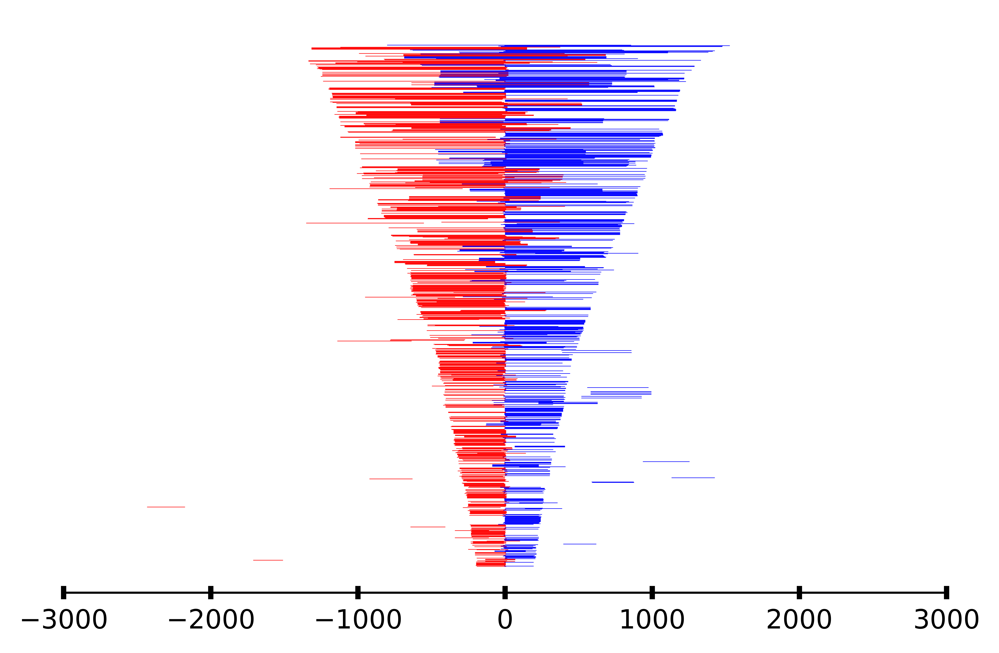

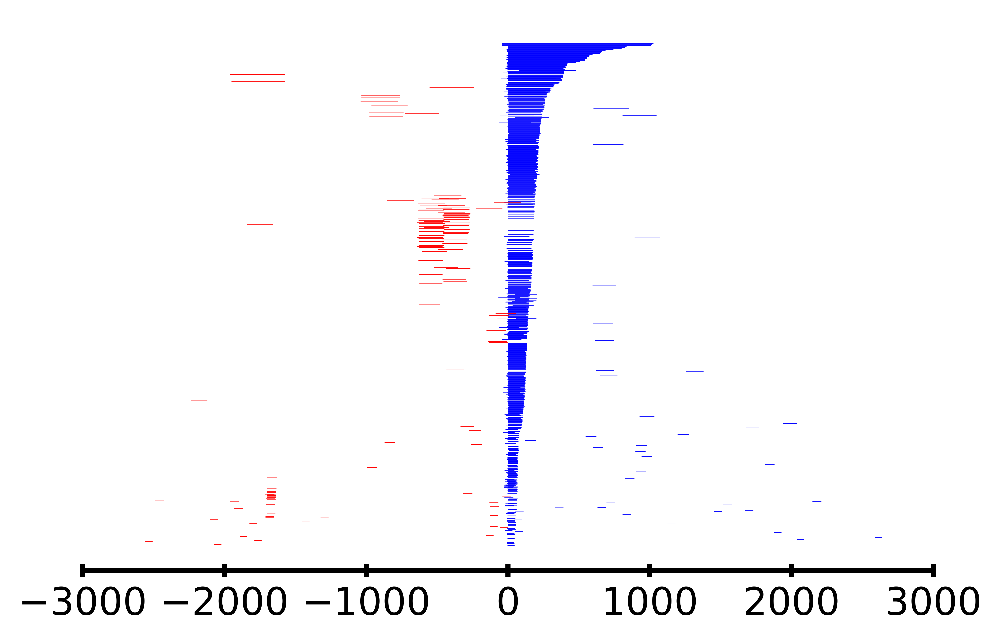

[[-5, 51],
 [0, 51],
 [-2073, 51],
 [-5, 51],
 [-6, 51],
 [-639, 51],
 [-8, 51],
 [-2114, 51],
 [-2559, 51],
 [1622, 51],
 [-1790, 51],
 [-5, 51],
 [2037, 51],
 [-5, 51],
 [-5, 51],
 [533, 52],
 [2588, 52],
 [-1699, 52],
 [-1892, 52],
 [-9, 52],
 [-155, 52],
 [-2262, 52],
 [-6, 53],
 [-5, 53],
 [-8, 53],
 [-1379, 53],
 [1875, 53],
 [-2063, 54],
 [50, 54],
 [-2, 54],
 [-24, 54],
 [-3, 54],
 [0, 54],
 [-4, 54],
 [-6, 54],
 [-118, 54],
 [-57, 55],
 [0, 55],
 [-129, 55],
 [-6, 55],
 [0, 55],
 [-129, 55],
 [0, 55],
 [1125, 55],
 [-1825, 55],
 [-1431, 56],
 [0, 56],
 [-1456, 56],
 [-6, 56],
 [-1251, 56],
 [-6, 56],
 [39, 57],
 [-2102, 57],
 [-1940, 57],
 [-6, 57],
 [-1323, 57],
 [-1711, 57],
 [-329, 57],
 [-1711, 57],
 [-4, 58],
 [-129, 58],
 [1736, 58],
 [807, 58],
 [-1700, 58],
 [-13, 58],
 [-129, 59],
 [-4, 59],
 [50, 59],
 [1451, 60],
 [627, 60],
 [1670, 60],
 [2, 60],
 [0, 60],
 [2, 60],
 [-1932, 60],
 [329, 61],
 [631, 61],
 [-18, 61],
 [-129, 62],
 [-1, 62],
 [-20, 62],
 [1517, 62],
 

<Figure size 6000x4000 with 0 Axes>

In [17]:
RedBlueViz(1000, dels, 0)
RedBlueViz(1000, ins, 1)

## Exploraion on Untreated Sample

In [18]:
samfile2 = pysam.AlignmentFile("BC02/BC02_sorted.bam", "rb")
samfile2.check_index()

True

In [19]:
tags2 = []
reads2 = []
for read in samfile2.fetch("NC_000011.9", 5245453, 5250942):
    reads2.append(read)

In [20]:
dels2, ins2 = getdelins(reads2)

In [21]:
VizStartPos(dels2, 0)
VizStartPos(ins2, 1)

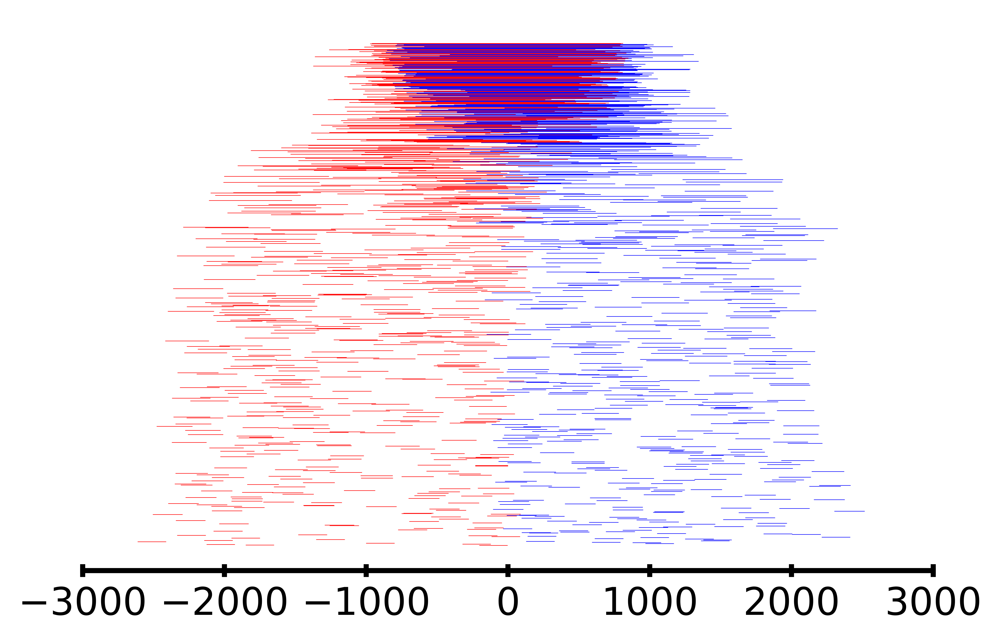

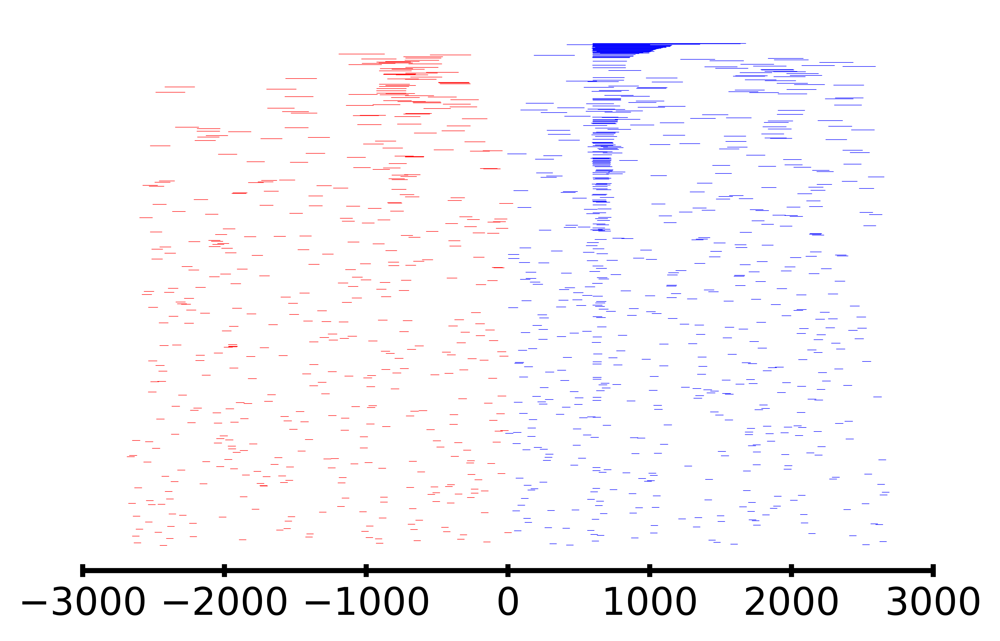

[[-2457, 51],
 [410, 51],
 [2499, 51],
 [1569, 51],
 [292, 51],
 [-932, 51],
 [-2640, 51],
 [1448, 51],
 [-175, 51],
 [2620, 51],
 [590, 51],
 [-667, 51],
 [1413, 51],
 [-1898, 51],
 [-359, 51],
 [-939, 51],
 [-2412, 51],
 [868, 51],
 [-1004, 51],
 [-1430, 51],
 [-2246, 51],
 [-2652, 51],
 [2406, 51],
 [627, 51],
 [-340, 51],
 [582, 51],
 [-1423, 51],
 [2118, 51],
 [1002, 51],
 [-26, 51],
 [-2493, 51],
 [-458, 51],
 [-1035, 51],
 [42, 51],
 [558, 51],
 [-1636, 51],
 [-689, 51],
 [-2626, 51],
 [-1584, 51],
 [384, 51],
 [258, 51],
 [-472, 52],
 [1304, 52],
 [-2405, 52],
 [-1002, 52],
 [1006, 52],
 [1729, 52],
 [2592, 52],
 [-708, 52],
 [2557, 52],
 [-2249, 52],
 [2065, 52],
 [117, 52],
 [-2561, 52],
 [1478, 52],
 [-1576, 52],
 [1720, 52],
 [-653, 52],
 [1698, 52],
 [590, 52],
 [1201, 52],
 [108, 52],
 [-911, 52],
 [1316, 52],
 [-2040, 52],
 [-1554, 52],
 [-2647, 52],
 [1473, 52],
 [-2321, 52],
 [1793, 52],
 [2060, 52],
 [-2394, 52],
 [648, 52],
 [856, 52],
 [-191, 52],
 [-1334, 52],
 [-1

<Figure size 6000x4000 with 0 Axes>

In [22]:
RedBlueViz(len(dels2), dels2, 0)
RedBlueViz(len(ins2), ins2, 1)

In [23]:
VizFrequencyChange(dels2, len(reads2), 0)
VizFrequencyChange(ins2, len(reads2), 1)

## Add Chimeric Reads 

In [24]:
samfile3 = pysam.AlignmentFile("BC01/BC01_Unmapped/BC01_Mapping_Unmapped_Sorted.bam", "rb")
samfile3.check_index()


True

In [25]:
def GetChimercDels(readfromsam):
    SAReads = []
    SAdic = {}
    # os.mkdir("BC01_SA.sam")
    for read in readfromsam.fetch("NC_000011.9", 5245453, 5250942):
        SAReads.append(read)
        if read.has_tag('SA'):
#             for j in read.cigar:
#                 if j[0] == 2 or j[0] == 0:
#                     l += j[1]
            if read.qname not in SAdic:
                if read.is_reverse:
                    SAdic.update({read.qname:[[read.pos, read.pos+read.reference_length, False]]})
                else:
                    SAdic.update({read.qname:[[read.pos, read.pos+read.reference_length, True]]})
            else:
                if read.is_reverse:
                    SAdic[read.qname].append([read.pos, read.pos+read.reference_length, False])
                else:
                    SAdic[read.qname].append([read.pos, read.pos+read.reference_length, True])
    SAlist = []
    for i in SAdic:
        j  = SAdic[i]
        if len(j) == 2:
            if j[0][0] < j[1][0]:
                if j[1][0]- j[0][1] > 200:
                    SAlist.append([j[0][1]-5248230, j[1][0] - j[0][1]])
#                     mixdel.append([j[0][1]-5248230, j[1][0] - j[0][1]])
    #                 print(j[0][1]-5248230, j[1][0] - j[0][1])
            else:
                if j[0][0] - j[1][1] > 200:
                    SAlist.append([j[1][1]-5248230, j[0][0] - j[1][1]])
#                     mixdel.append([j[1][1]-5248230, j[0][0] - j[1][1]])
    return SAlist, len(SAReads)

In [26]:
SA_Unmapped, Unmapped_Read_Len = GetChimercDels(samfile3)
SA_NGMLR, NGMLR_Len = GetChimercDels(samfile1)

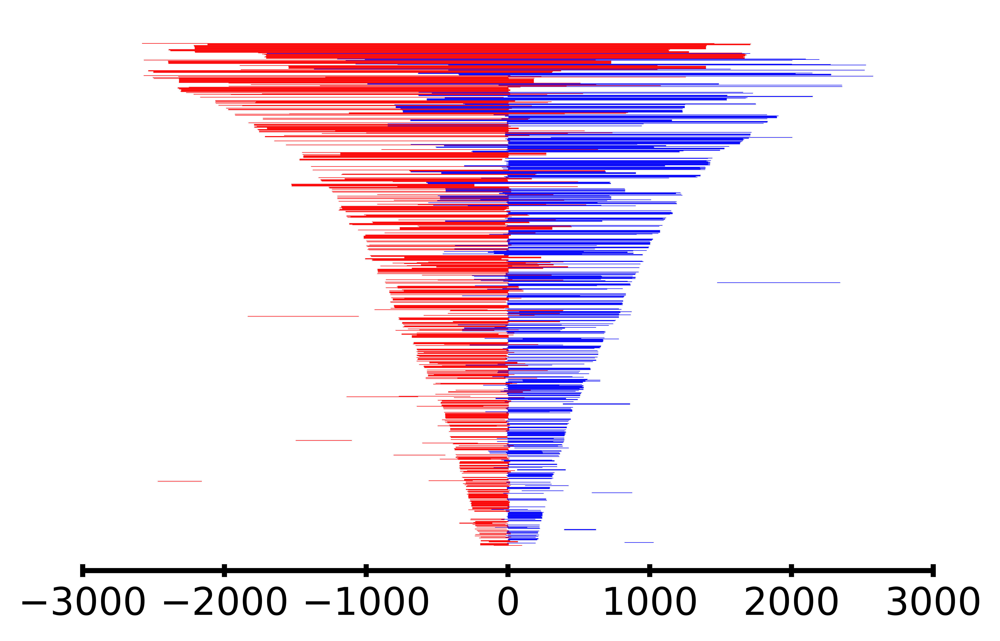

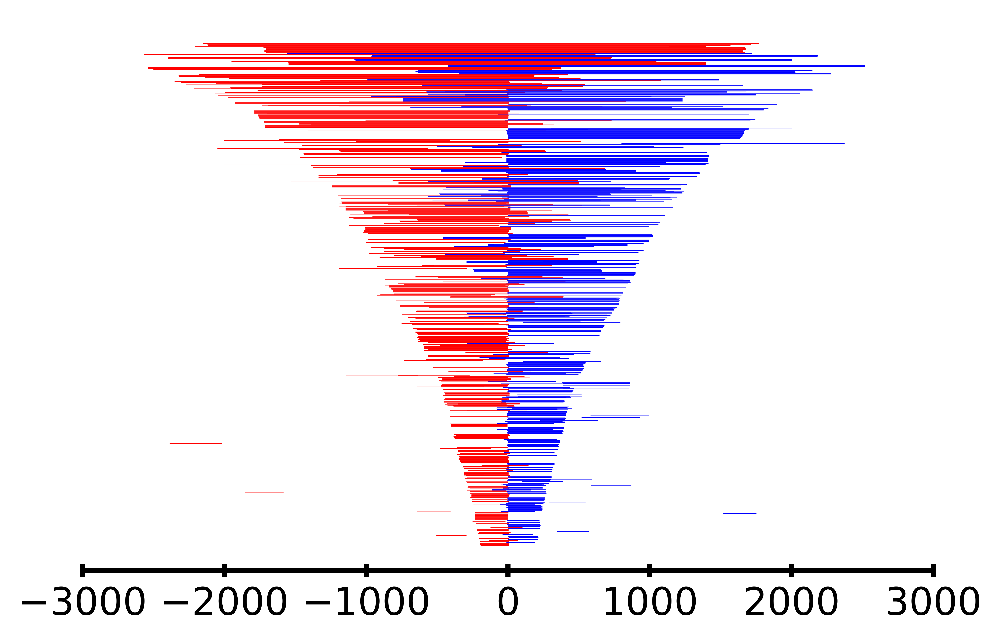

[[-194, 200],
 [-194, 200],
 [-197, 201],
 [-197, 201],
 [-197, 201],
 [-197, 201],
 [-12, 201],
 [-197, 201],
 [-197, 202],
 [-204, 204],
 [-136, 205],
 [-2095, 207],
 [-1, 209],
 [-209, 210],
 [-205, 210],
 [-205, 210],
 [3, 211],
 [-3, 211],
 [-3, 211],
 [-206, 212],
 [-507, 213],
 [-212, 214],
 [-39, 215],
 [-5, 218],
 [-215, 219],
 [-61, 220],
 [-203, 220],
 [-61, 220],
 [347, 221],
 [-221, 222],
 [-221, 224],
 [-230, 224],
 [-221, 224],
 [-1, 224],
 [-1, 224],
 [395, 225],
 [-125, 226],
 [-219, 226],
 [-1, 226],
 [-9, 227],
 [1, 228],
 [-8, 229],
 [-7, 231],
 [-227, 231],
 [-227, 231],
 [-15, 231],
 [-7, 231],
 [-3, 231],
 [-251, 232],
 [-232, 232],
 [-10, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [-234, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [-232, 232],
 [1518, 234],
 [-232, 234],
 [-232, 234],
 [-644, 238],
 [-48, 240],
 [-648, 241],
 [-3, 243],
 [-2, 244],
 [-2, 244],
 [-2, 244],
 [-2, 244]

<Figure size 6000x4000 with 0 Axes>

In [27]:
RedBlueViz(1000, dels+SA_Unmapped+SA_NGMLR, 0)
RedBlueViz(1000, dels+SA_Unmapped+SA_NGMLR, 1)


In [28]:
print("The Longest Deletion is in location: " + str(GetMaxLocations(dels+SA_NGMLR+SA_Unmapped)))

The Longest Deletion is in location: 230234


In [29]:
DelswithBWA = dels+SA_Unmapped
DelsWhole = dels+SA_Unmapped+SA_NGMLR
DelswithBWA_string = str(DelswithBWA).strip('[]')
DelsWhole_string = str(DelsWhole).strip('[]')
# print(DelsWhole)

text_file = open("../DelswithBWA.txt", "w")
n = text_file.write(DelswithBWA_string)
text_file.close()


In [30]:
def del_to_group(df_del,output):
    df_group = df_del.groupby(df_del.columns.tolist()).size().reset_index(). \
        rename(columns={0: 'repeat_num'})
    df_group.to_csv(output, index=False)
    
cutsite = 5248229
length = 5465
chr = 'chr11'

#df_Nanopore = pd.DataFrame.from_records(DelsWhole, columns=['start', 'length'])
#del_to_group(df_Nanopore,'../DelsWhole_group.csv')

df_Nanopore = pd.DataFrame.from_records(DelswithBWA, columns=['start', 'length'])
del_to_group(df_Nanopore,'../DelswithBWA_group.csv')


### % of Deletion and Insertions found in CRISPR treated and Untreated Samples

In [31]:
fig = go.Figure()
fig.add_trace(go.Bar(x= ['Ins', 'Del'], y=[100*9295/len(reads), 100*162366/len(reads)], name='CRISPR Treated'))
fig.add_trace(go.Bar(x= ['Ins', 'Del'], y=[100*1133/len(reads2), 100*1088/len(reads2)], name='Untreated'))
fig.update_layout(
    title="% of Deletion and Insertions found in CRISPR treated and Untreated Samples",
    yaxis_title="% of INDEL",
    )
fig.show()

## Inteval Tree

In [32]:
dels_all_tuple = []
for i in dels+SA_NGMLR+SA_Unmapped:
    dels_all_tuple.append((i[0], i[0]+i[1]))
t = IntervalTree.from_tuples(dels_all_tuple)
cross_0 = list(t[0])


## Clustering - with Unmapped

In [33]:
newdels = DelswithBWA
locdic = {}
for i in newdels:
    temploc = int(i[1]/100)*100
    if temploc not in locdic:
        locdic.update({temploc:0})
    else:
        locdic[temploc] += 1
locs =  [str(i) for i in np.array(list(locdic.keys()))]
loccnts = np.array(list(locdic.values()))/Unmapped_Read_Len/100
fig = go.Figure(
    data=[go.Bar(x = locs, y=loccnts)],
)
fig.update_layout(
    title="Deletion lengths distribution in Mapping from BWA-MEM with previously Unmapped Reads <br>(Number of Deletions / Number of Reads)",
    xaxis_title="Deletions Lengths",
    yaxis_title="% of Deletions",
    )
fig.show()

# Visualize GC content with deletions 

In [34]:
# HBB_Seq = SeqIO.FastaIO()
with open("hg19-ch11-HBB.fasta") as handle:
    for record in SeqIO.FastaIO.SimpleFastaParser(handle):
        HBB_Seq = record[1]

In [35]:
def calcgc(sequence, windowsize):
    percentlist = []
    for i in range(0, len(sequence)-windowsize):
        temp = 0
        for j in sequence[i:i+windowsize]:
            if j == 'G' or j == 'C':
                temp += 1
        percentlist.append(5000*(temp/windowsize))
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=list(range(int(-len(sequence)/2),  int(len(sequence)/2)-windowsize)), y=percentlist,
                        mode='lines'))
    fig.add_trace(go.Scatter(x=dels_1, y=dels_2, mode='markers'))
    fig.show()

## Read Illumina Data

In [36]:
df = pd.read_csv("./Illumina/large_run_group.csv")

In [37]:
all_dels_SR = df.values
all_dels_SR_nr = []
for i in all_dels_SR:
    for j in range(i[2]):
        all_dels_SR_nr.append([i[0]-5248230, i[1]])

## Compare with Illumina

In [38]:
def ComparewithIllumina(indel_long, read_len_long, indel_short, read_len_short):
    indel_long.sort(key=lambda x:(x[0]))
    indel_short.sort(key=lambda x:(x[0]))
    locdic = {}
    loccnts=[]
    for i in indel_long:
        temploc = int(i[1]/100)*100
        if temploc not in locdic:
            locdic.update({temploc:0})
        else:
            locdic[temploc] += 1
    locs =  [str(i) for i in np.array(list(sorted(locdic.keys())))]
    for i in sorted(locdic.keys()):
        loccnts.append(100*locdic[i]/len(reads))

        
    locdic_SR = {}
    loccnts_SR = []
    for i in indel_short:
        temploc = int(i[1]/100)*100
        if temploc not in locdic_SR:
            locdic_SR.update({temploc:0})
        else:
            locdic_SR[temploc] += 1

    locs_SR =  [str(i) for i in np.array(list(sorted(locdic_SR.keys())))]
    for i in sorted(locdic_SR.keys()):
        loccnts_SR.append(100*locdic_SR[i]/read_len_short)
#         loccnts_SR.append(locdic_SR[i]/1327998)

    fig = go.Figure()
    fig.add_trace(go.Bar(x= locs, y=loccnts,  name='Long Reads'))
    fig.add_trace(go.Scatter(x= locs, y=loccnts,  name='Long Reads'))
    fig.add_trace(go.Bar(x= locs_SR, y=loccnts_SR, name='Short Reads'))
    fig.add_trace(go.Scatter(x= locs_SR, y=loccnts_SR, name='Short Reads'))

    fig.update_layout(
        title="Deletion lengths distribution in Nanopore and Illumina Sequenced Samples <br> (Number of Deletions / Number of Reads)",
        xaxis_title="Deletions Lengths",
        yaxis_title="Percentage of Deletions",
        )
    fig.show()

In [39]:
ComparewithIllumina(DelswithBWA, len(reads) + Unmapped_Read_Len, all_dels_SR_nr, 1327998)
len(reads) + Unmapped_Read_Len

828576

### With NGMLR Chimeric Reads

In [40]:
ComparewithIllumina(DelsWhole, len(reads) + Unmapped_Read_Len, all_dels_SR_nr, 1327998)
print()

In [41]:
ComparewithIllumina(DelsWhole, 100, all_dels_SR_nr, 100)

### Similarity with Illumina - Direct Viz

In [42]:
def DelDistribution(indel):
    dels_lr_1 = []
    dels_lr_2 = []
    for i in indel1:
        dels_lr_1.append(i[0]+i[1]/2)
        dels_lr_2.append(i[1])
    plt.figure()
    plt.scatter(x= dels_lr_1, y=dels_lr_2, s=.1,alpha=0.3, label="Profile1")
    plt.xlabel("Deletion Middle Point Locations")
    plt.ylabel("Deletion Lengths")
    plt.legend(fontsize = "xx-small")
    plt.show()

In [43]:
def ShowtwoDistribution(indel1, indel2):
    dels_lr_1 = []
    dels_lr_2 = []
    for i in indel1:
        dels_lr_1.append(i[0]+i[1]/2)
        dels_lr_2.append(i[1])

    dels_sr_1 = []
    dels_sr_2 = []
    for i in indel2:
        dels_sr_1.append(i[0]+i[1]/2)
        dels_sr_2.append(i[1])


    plt.figure()
    plt.scatter(x= dels_lr_1, y=dels_lr_2, s=.1,alpha=0.3, label="Profile1")
    plt.scatter(x= dels_sr_1, y=dels_sr_2, s=.1,alpha=0.3, label="Profile2")
    plt.xlabel("Deletion Middle Point Locations")
    plt.ylabel("Deletion Lengths")
    plt.legend(fontsize = "xx-small")
    plt.show()

#### Distribution with only chimeric read from Unmappeed Reads

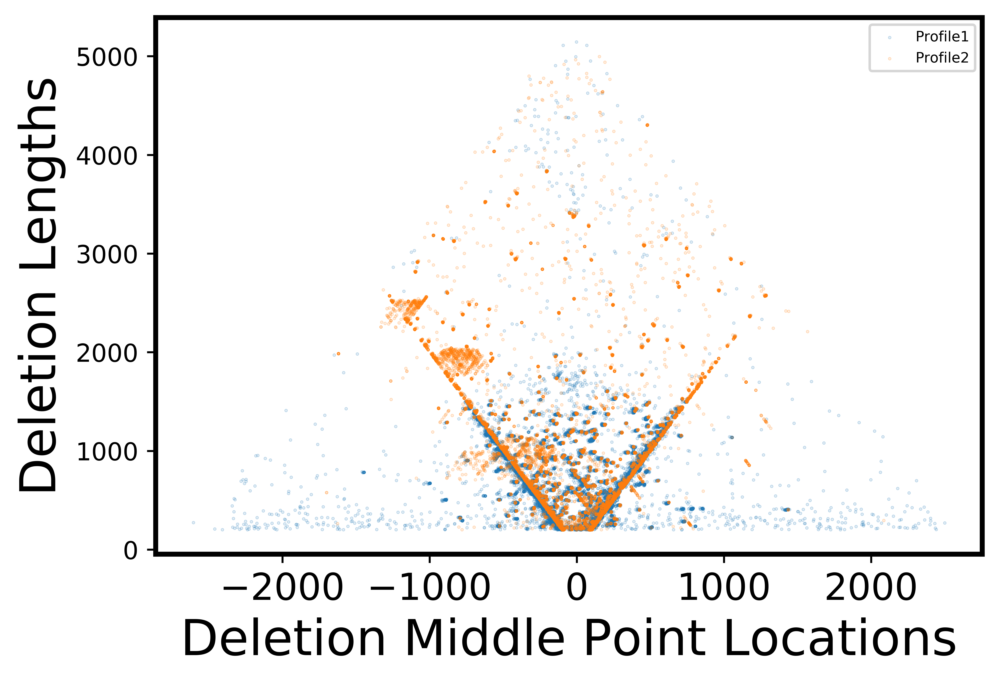

In [44]:
ShowtwoDistribution(DelswithBWA, all_dels_SR_nr)

#### Distribution with chimeric read from Unmappeed Reads and NGMLR

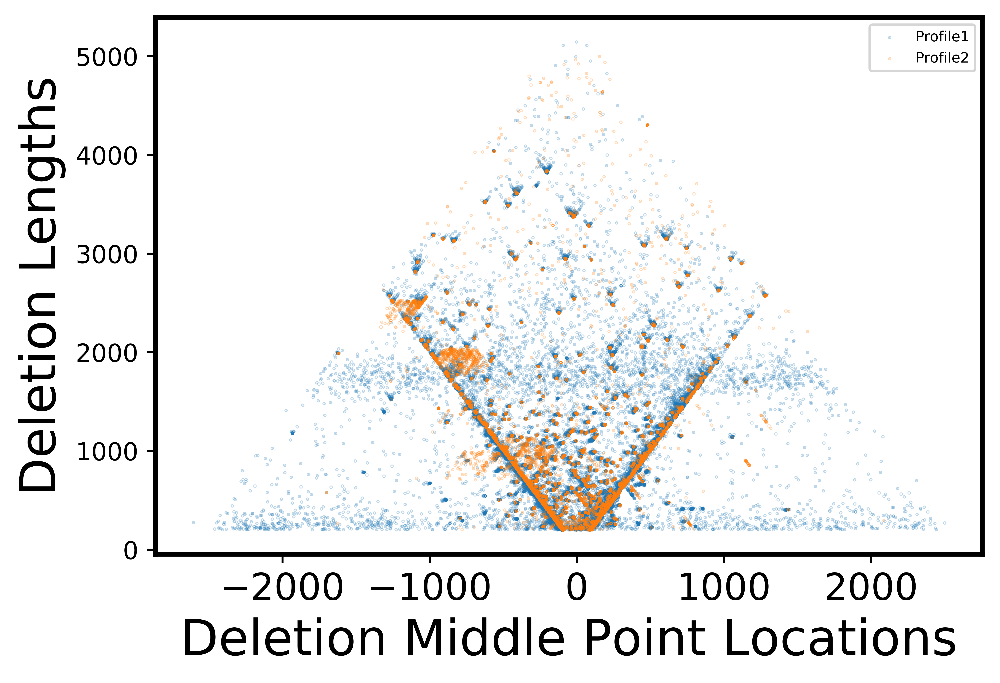

In [45]:
ShowtwoDistribution(DelsWhole, all_dels_SR_nr)

# DBSCAN

In [46]:
def DBCluster(e, indel):
    dbscan_clusters = DBSCAN(eps=e).fit(indel)
    labels = dbscan_clusters.labels_
#     n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    clstrdic = {}
    for j in range(len(indel)):
        if labels[j] != -1:
            if labels[j] not in clstrdic:
                clstrdic.update({labels[j] : [indel[j]]})
            else:
                clstrdic[labels[j]].append(indel[j])
    return clstrdic

def RunDBCluster_Multiple(circletimes, start, indel):
    clusternum_LR = []
    epslist_LR = []
    for k in tqdm(range(circletimes)):
        dd = DBCluster(start, indel)
        for i in dd:
            temp_1 = []
            temp_2 = []
            for j in dd[i]:
                temp_1.append(j[0]+j[1]/2)
                temp_2.append(j[1])
        clusternum_LR.append(len(dd))
        epslist_LR.append(start)
        start += 0.1
    fig = go.Figure()
    fig.add_trace(go.Bar(x= epslist_LR, y=clusternum_LR,  name='cluster numbers change with max distance'))
    fig.show()
    return clusternum_LR

In [47]:
Nanopore_Cluster200 = RunDBCluster_Multiple(200, 0.5, DelswithBWA)

100%|██████████| 200/200 [15:23<00:00,  4.62s/it]


#### DBSCANS for Illumina Samples

In [48]:
def get_clusters(filename):
    df = pd.read_csv(filename)
    SR_Dels = []
    for i in df.values:
        for j in range(i[2]):
            SR_Dels.append([i[0] - 5248230, i[1]])
    clusternum_SR = []
    start = 0.5
    epslist_SR = []
    for k in tqdm(range(200)):
        dbscan_clusters = DBSCAN(eps=start).fit(SR_Dels)
        clstrdic = {}
        labels = dbscan_clusters.labels_
        for j in range(len(SR_Dels)):
            if labels[j] != -1:
                if labels[j] not in clstrdic:
                    clstrdic.update({labels[j] : [SR_Dels[j]]})
                else:
                    clstrdic[labels[j]].append(SR_Dels[j])

        clusternum_SR.append(len(clstrdic))
        epslist_SR.append(start)
        start += 0.1
    return clusternum_SR

In [49]:
final_clusters = {}
for m in os.listdir("For_Clustering/"):
    final_clusters.update({m.split(".")[0]:get_clusters("For_Clustering/"+m)})
start = 0.5
epslist_SR = []
for k in range(200):
    epslist_SR.append(start)
    start += 0.1
fig = go.Figure()
fig.add_trace(go.Line(x= epslist_SR, y = Nanopore_Cluster200,  name='HiFi CRISPR Cas9 System R66SCD targeting to HBB Region, Nanopore High coverage'))
for i in final_clusters:
    fig.add_trace(go.Line(x= epslist_SR, y=final_clusters[i], name = i))
fig.update_layout(
    title={'text':"Cluster Number Changes with ε in different Samples",
           'y':0.01,
          },
    xaxis_title="ε",
    yaxis_title="Cluster Numbers",
    legend=dict(x=0, y=1.8, font=dict(size=7)),
    )
fig.show()

100%|██████████| 200/200 [13:57<00:00,  4.19s/it]
/home/Users/yp11/anaconda3/envs/py36yp/lib/python3.6/site-packages/plotly/graph_objs/_deprecations.py:385: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




### Clusters Visualization

In [50]:
def ClustersViz(e, indel):
    clstrdic = DBCluster(e, indel)
    plt.figure()
    plt.axis([-1500,1500,0,5000])
    for i in clstrdic:
        temp_1 = []
        temp_2 = []
        for j in clstrdic[i]:
            temp_1.append(j[0]+j[1]/2)
            temp_2.append(j[1])
        plt.scatter(x=temp_1, y=temp_2, s=0.001)
    plt.xlabel("Deletion Middle Point Locations")
    plt.ylabel("Deletion Lengths")
    plt.show()

In [51]:
def ClusterDelFreqViz(e1, indel1, e2, indel2, eventnum, model):
    if model == 0:
        clstrdic_lr = DBCluster(e1, indel1)
        clstrdic_sr = DBCluster(e2, indel2)
    elif model == 1:
        clstrdic_lr = HDBCluster(e1, indel1)
        clstrdic_sr = HDBCluster(e2, indel2)
    dels_lr_cluster_max = []
    for i in clstrdic_lr:
        c_t = tuple(tuple([y for y in x]) for x in clstrdic_lr[i])
        dels_lr_cluster_max.append(Counter(c_t).most_common(1)[0][0])
    dels_sr_cluster_max = []
    for i in clstrdic_sr:
        c_t = tuple(tuple([y for y in x]) for x in clstrdic_sr[i])
        dels_sr_cluster_max.append(Counter(c_t).most_common(1)[0][0])
    dels_lr_cluster_max.sort(key=lambda x:(x[0]))
    locdic = {}
    loccnts=[]
    for i in dels_lr_cluster_max:
        temploc = int(i[1]/100)*100
        if temploc not in locdic:
            locdic.update({temploc:0})
        else:
            locdic[temploc] += 1

    locs =  [str(i) for i in np.array(list(sorted(locdic.keys())))]
    for i in sorted(locdic.keys()):
        loccnts.append(100*locdic[i]/eventnum)
#         loccnts.append(100*locdic[i]/10000)


    dels_sr_cluster_max
    locdic_SR = {}
    loccnts_SR = []
    for i in dels_sr_cluster_max:
        temploc = int(i[1]/100)*100
        if temploc not in locdic_SR:
            locdic_SR.update({temploc:0})
        else:
            locdic_SR[temploc] += 1

    locs_SR =  [str(i) for i in np.array(list(sorted(locdic_SR.keys())))]
    for i in sorted(locdic_SR.keys()):
        loccnts_SR.append(100*locdic_SR[i]/eventnum)


    fig = go.Figure()
    fig.add_trace(go.Bar(x= locs, y=loccnts,  name='Profile Cluster1'))
    fig.add_trace(go.Scatter(x= locs, y=loccnts,  name='Profile Cluster1'))
    fig.add_trace(go.Bar(x= locs_SR, y=loccnts_SR, name='Profile Cluster2'))
    fig.add_trace(go.Scatter(x= locs_SR, y=loccnts_SR, name='Profile Cluster2'))

    fig.update_layout(
        title="Clustered Deletion lengths distribution of the intersection <br> (Number of Deletions / Number Read)",
        xaxis_title="Deletions Lengths",
        yaxis_title="Percentage of Deletions",
        )
    fig.show()

In [52]:
def ClusterDistribution(e, indel):
    dels_lr_cluster_max = []
    clstrdic_lr = DBCluster(e, indel)
    for i in clstrdic_lr:
        c_t = tuple(tuple([y for y in x]) for x in clstrdic_lr[i])
        dels_lr_cluster_max.append(Counter(c_t).most_common(1)[0][0])
    profile = RedBlueViz(len(dels_lr_cluster_max), dels_lr_cluster_max, 0)
    return profile

In [53]:
def de_noise(e, indel, indel2):
    clstrdic = DBCluster(e, indel)
    clstrdic2 = DBCluster(e, indel2)
    plt.figure()
    plt.axis([-1500,1500,0,5000])
    temp_1 = []
    temp_2 = []
    for i in clstrdic:
        for j in clstrdic[i]:
            temp_1.append(j[0]+j[1]/2)
            temp_2.append(j[1])
    plt.scatter(x=temp_1, y=temp_2, s=0.001)
    temp_1 = []
    temp_2 = []
    for i in clstrdic2:
        for j in clstrdic2[i]:
            temp_1.append(j[0]+j[1]/2)
            temp_2.append(j[1])
    plt.scatter(x=temp_1, y=temp_2, s=0.001)
    plt.xlabel("Deletion Middle Point Locations")
    plt.ylabel("Deletion Lengths")
    plt.show()

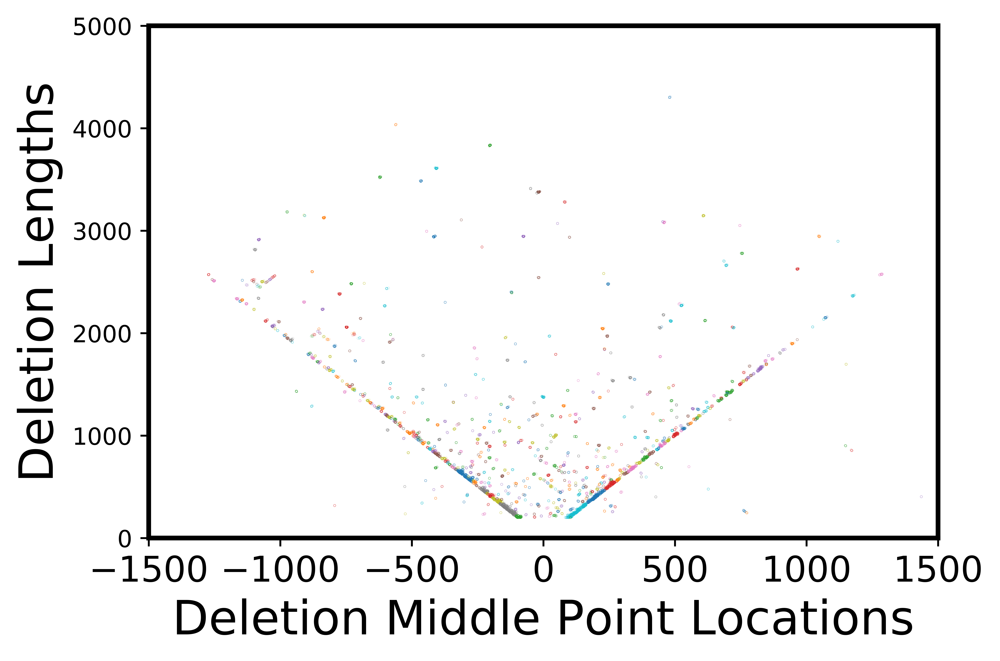

In [54]:
ClustersViz(5.1, all_dels_SR_nr)

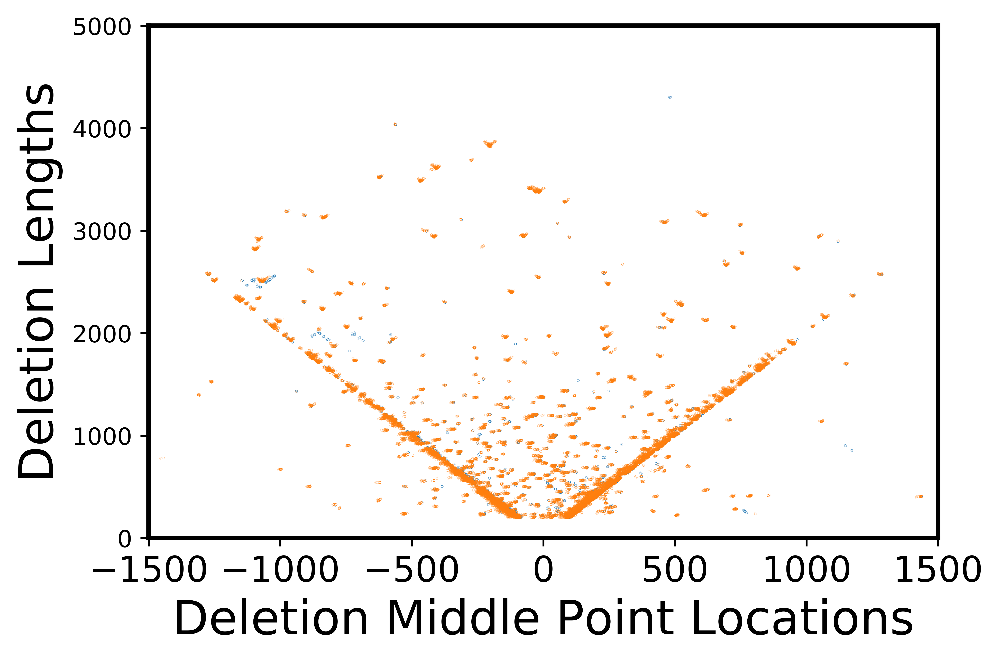

In [55]:
de_noise(5.1, all_dels_SR_nr, DelsWhole)

#### Deletion Clusters profile comparasion with only Unmapped chimeric reads

In [56]:
ClusterDelFreqViz(2.9, DelswithBWA, 2.9, all_dels_SR_nr, 10000, 0)

#### Deletion Clusters profile comparasion with Unmapped chimeric reads and NGMLR chimeric reads(e = 5.1)

In [57]:
ClusterDelFreqViz(5.1, DelsWhole, 5.1, all_dels_SR_nr, 10000, 0)

In [58]:
ClusterDelFreqViz(5.1, DelsWhole, 0.5, all_dels_SR_nr, 10000, 0)

### Upper bound identified with Huge Drop

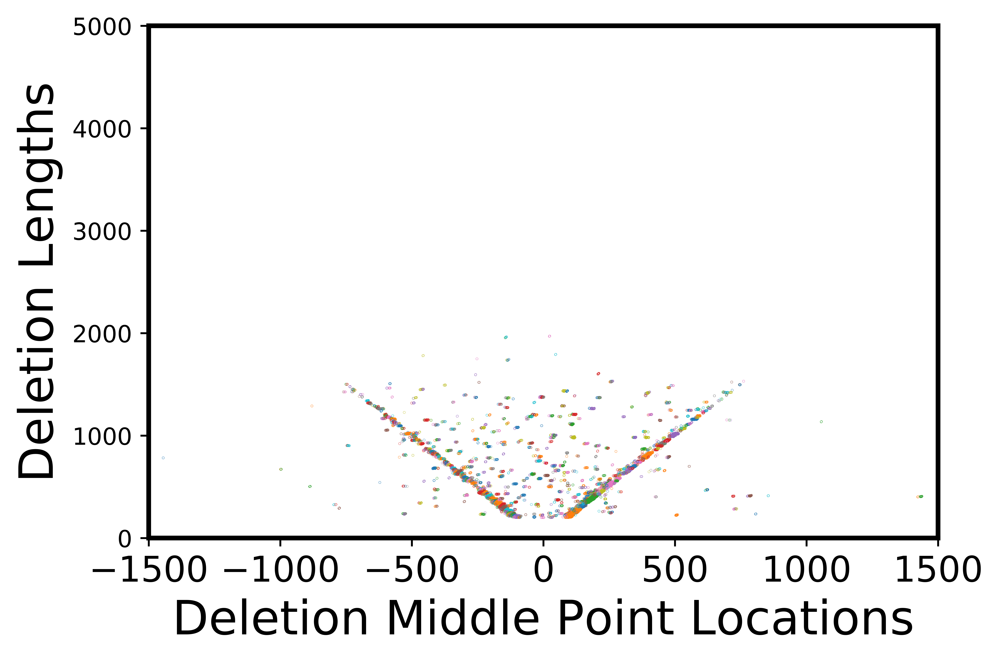

In [59]:
ClustersViz(2.1, DelswithBWA)

#### Lower bound identified with Huge Drop

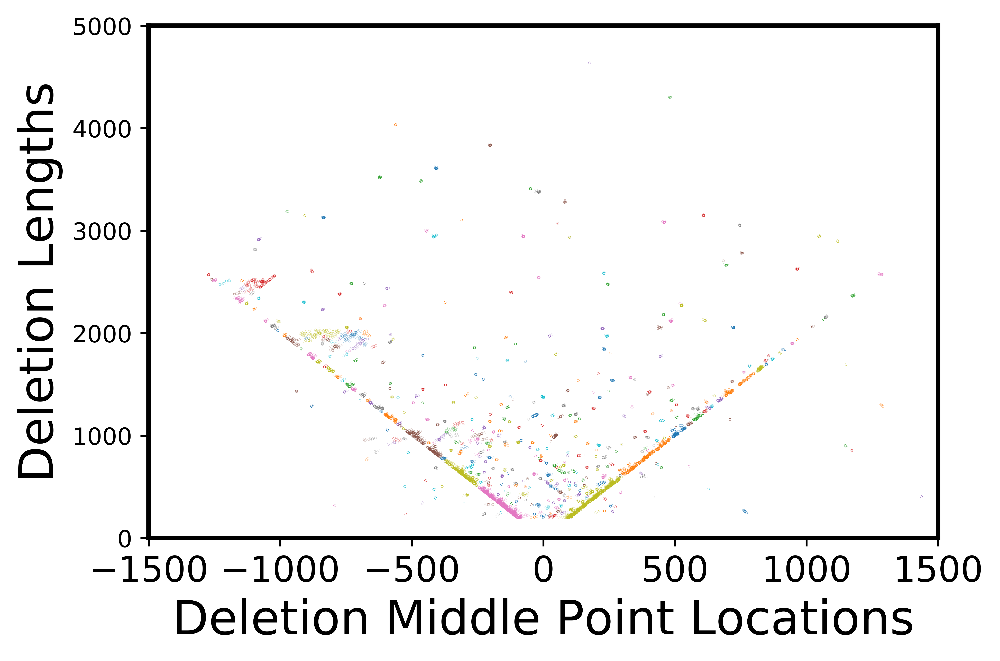

In [60]:
ClustersViz(12.1, all_dels_SR_nr)

#### Upper Bound Distribution Viz

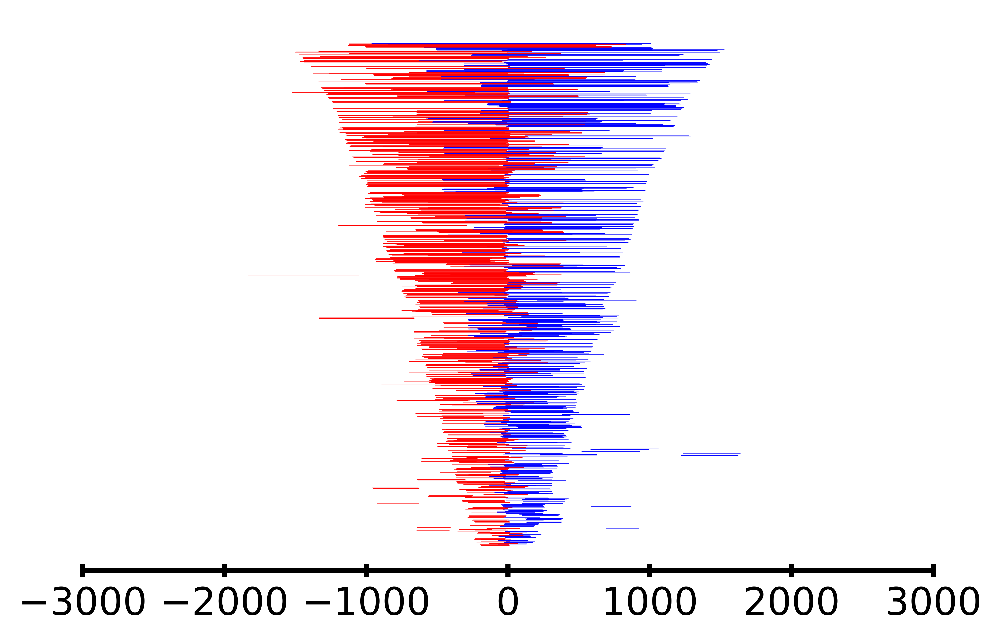

[(-190, 200),
 (-101, 200),
 (-197, 201),
 (-72, 202),
 (-68, 203),
 (-136, 205),
 (-216, 206),
 (-30, 206),
 (-223, 207),
 (-193, 207),
 (-16, 207),
 (-84, 209),
 (-72, 211),
 (-229, 212),
 (-238, 214),
 (-193, 214),
 (-197, 215),
 (-234, 216),
 (-30, 218),
 (-22, 218),
 (-200, 219),
 (-68, 220),
 (-61, 220),
 (-64, 221),
 (-116, 224),
 (-252, 225),
 (9, 225),
 (395, 225),
 (-219, 226),
 (-125, 226),
 (-92, 227),
 (-215, 229),
 (-182, 229),
 (-22, 230),
 (-357, 231),
 (-232, 232),
 (-646, 233),
 (-32, 233),
 (-347, 234),
 (-251, 234),
 (-151, 234),
 (689, 236),
 (-355, 237),
 (-644, 238),
 (-653, 239),
 (-59, 239),
 (-22, 239),
 (-48, 240),
 (-268, 242),
 (-94, 243),
 (-30, 243),
 (-103, 244),
 (-25, 244),
 (-2, 244),
 (-234, 245),
 (130, 246),
 (134, 246),
 (-238, 248),
 (-347, 249),
 (-254, 249),
 (1, 249),
 (-247, 250),
 (124, 252),
 (-264, 253),
 (134, 253),
 (120, 254),
 (-286, 256),
 (-30, 256),
 (-268, 258),
 (-275, 259),
 (-279, 260),
 (96, 260),
 (-274, 262),
 (79, 263),
 (10

<Figure size 6000x4000 with 0 Axes>

In [61]:
ClusterDistribution(2.1, DelswithBWA)

#### Lower bound Distribution Viz

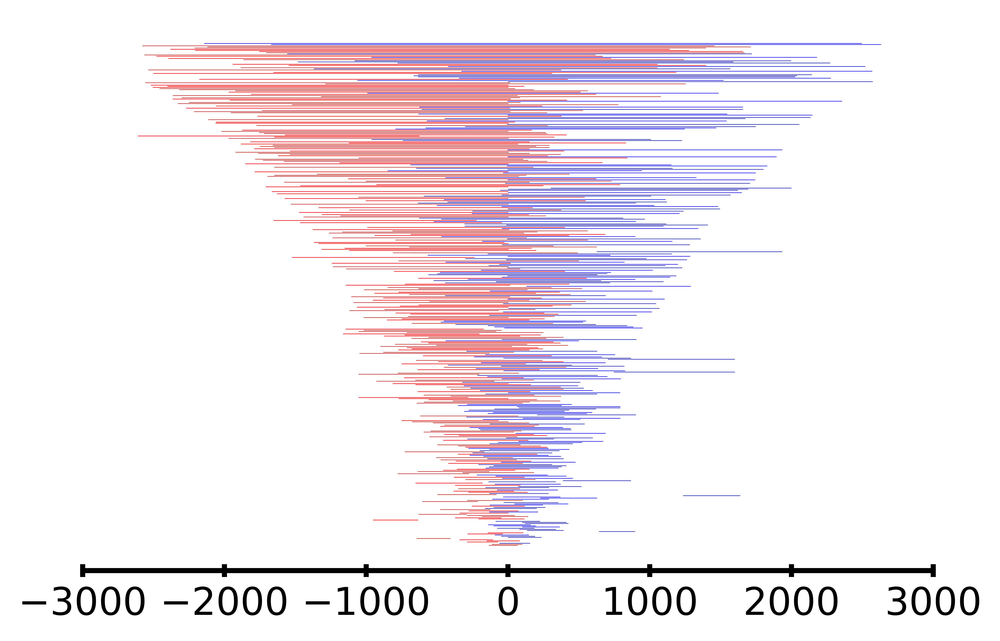

[(-136, 204),
 (-116, 216),
 (-61, 216),
 (-289, 218),
 (-151, 233),
 (-343, 236),
 (-644, 237),
 (-2, 238),
 (-48, 238),
 (-94, 241),
 (-286, 248),
 (-144, 252),
 (641, 255),
 (134, 258),
 (79, 259),
 (-77, 262),
 (100, 264),
 (-103, 299),
 (-141, 301),
 (120, 305),
 (99, 312),
 (-88, 313),
 (-953, 319),
 (-210, 326),
 (-374, 327),
 (-185, 327),
 (-289, 336),
 (-633, 342),
 (-342, 344),
 (-134, 345),
 (-278, 351),
 (-479, 353),
 (-163, 365),
 (-103, 366),
 (-256, 373),
 (-129, 375),
 (45, 379),
 (-31, 385),
 (-605, 390),
 (-288, 392),
 (-112, 401),
 (226, 402),
 (-36, 404),
 (1234, 404),
 (-498, 415),
 (-133, 418),
 (-281, 419),
 (-385, 426),
 (-78, 428),
 (-351, 433),
 (-160, 448),
 (70, 448),
 (-374, 461),
 (-95, 466),
 (-654, 474),
 (-139, 475),
 (387, 479),
 (-301, 494),
 (-42, 498),
 (-383, 499),
 (-88, 499),
 (-221, 500),
 (-779, 503),
 (-320, 503),
 (-638, 504),
 (-458, 508),
 (-362, 512),
 (-158, 512),
 (-135, 514),
 (-103, 514),
 (-210, 520),
 (-422, 526),
 (-51, 526),
 (-369

<Figure size 6000x4000 with 0 Axes>

In [62]:
ClusterDistribution(12.1, all_dels_SR_nr)

# DELLY Viz

In [63]:
with open('Illumina/BC01_SR_DELLY_True_DELs_Parsing.txt', "r") as f:
    delsinfo = f.readlines()

In [64]:
dels_from_DELLY = []
for i in delsinfo[1:]:
    tempstr = i[:-1].split("\t")
    begin = int(tempstr[1])-5248230
    end = int(tempstr[7].split(";")[4].split("=")[1])-5248230
    dels_from_DELLY.append([begin,end])

Text(0, 0.5, 'Read IDs')

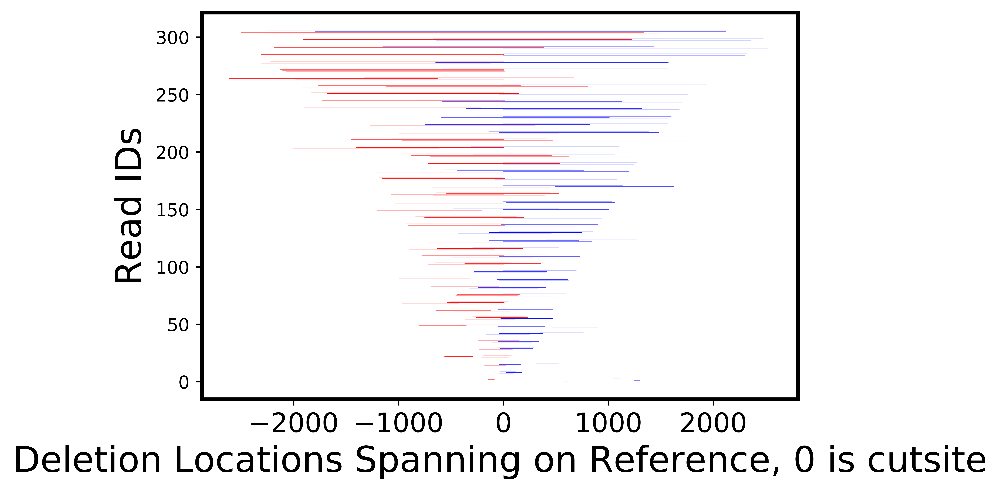

In [65]:
dels_from_DELLY.sort(key=lambda x:(x[1]-x[0]))
for i in range(len(dels_from_DELLY)):
    if (dels_from_DELLY[i][0]+dels_from_DELLY[i][1])/2.0 < 0:
        plt.hlines(i, dels_from_DELLY[i][0], dels_from_DELLY[i][1], lw = 0.1, colors="red")
    else:
        plt.hlines(i, dels_from_DELLY[i][0], dels_from_DELLY[i][1], lw = 0.1, colors="blue")
plt.xlabel("Deletion Locations Spanning on Reference, 0 is cutsite")
plt.ylabel("Read IDs")


In [66]:
dels_DL_max = []
for i in dels_from_DELLY:
    dels_DL_max.append([i[0], i[1] -i[0]])

In [67]:
clstrdic_lr = DBCluster(2.1, DelswithBWA)
clstrdic_sr = DBCluster(12.1, all_dels_SR_nr)
dels_lr_cluster_max = []
for i in clstrdic_lr:
    c_t = tuple(tuple([y for y in x]) for x in clstrdic_lr[i])
    dels_lr_cluster_max.append(Counter(c_t).most_common(1)[0][0])
dels_sr_cluster_max = []
for i in clstrdic_sr:
    c_t = tuple(tuple([y for y in x]) for x in clstrdic_sr[i])
    dels_sr_cluster_max.append(Counter(c_t).most_common(1)[0][0])
dels_lr_cluster_max.sort(key=lambda x:(x[0]))
dels_sr_cluster_max.sort(key=lambda x:(x[0]))

locdic = {}
loccnts=[]
for i in dels_lr_cluster_max:
    temploc = int(i[1]/100)*100
    if temploc not in locdic:
        locdic.update({temploc:0})
    else:
        locdic[temploc] += 1
locs =  [str(i) for i in np.array(list(sorted(locdic.keys())))]
for i in sorted(locdic.keys()):
    loccnts.append(100*locdic[i]/10000)

locdic_SR = {}
loccnts_SR = []
for i in dels_sr_cluster_max:
    temploc = int(i[1]/100)*100
    if temploc not in locdic_SR:
        locdic_SR.update({temploc:0})
    else:
        locdic_SR[temploc] += 1
locs_SR =  [str(i) for i in np.array(list(sorted(locdic_SR.keys())))]
for i in sorted(locdic_SR.keys()):
    loccnts_SR.append(100*locdic_SR[i]/10000)

newdels_DL = dels_DL_max
locdic_DL = {}
loccnts_DL = []
for i in newdels_DL:
    temploc = int(i[1]/100)*100
    if temploc not in locdic_DL:
        locdic_DL.update({temploc:0})
    else:
        locdic_DL[temploc] += 1

locs_DL =  [str(i) for i in np.array(list(sorted(locdic_DL.keys())))]
for i in sorted(locdic_DL.keys()):
    loccnts_DL.append(100*locdic_DL[i]/10000)
    
fig = go.Figure()
fig.add_trace(go.Bar(x= locs, y=loccnts,  name='Upperbound'))
fig.add_trace(go.Scatter(x= locs, y=loccnts,  name='Upperbound'))
fig.add_trace(go.Bar(x= locs_SR, y=loccnts_SR, name='Lowerbound'))
fig.add_trace(go.Scatter(x= locs_SR, y=loccnts_SR, name='Lowerbound'))
fig.add_trace(go.Bar(x= locs_DL, y=loccnts_DL, name='DELLY'))
fig.add_trace(go.Scatter(x= locs_DL, y=loccnts_DL, name='DELLY'))
fig.update_layout(
    title="Clustered Deletion lengths distribution from Upper bound Clusters, Lower bound clusters and DELLY<br> (Number of Deletions / Number Read)",
    xaxis_title="Deletions Lengths",
    yaxis_title="Percentage of Deletions",
    )
fig.show()

# Final Cluster Numbers

In [68]:
Total_Dels = len(DelswithBWA)
UpperCluster = 1193
LowerCluster = 435
DELLY_num = len(newdels_DL)

#### Side Job: Viz of breakpoint Normal Distribution in a cluster

In [69]:
endpoint = []
for i in DBCluster(2.9, DelswithBWA)[50]:
    endpoint.append(i[0]+i[1])
    
fig = go.Figure()
fig.add_trace(go.Bar(y= list(dict(Counter(endpoint)).values()), x=list(dict(Counter(endpoint)).keys())))
fig.update_layout(
    title="Distribution of Breakpoints of one Deletion",
    xaxis_title="Breakpoints locations",
    yaxis_title="Number of Breakpoints",
    )
fig.show()

### HDBSCAN

In [70]:
def HDBCluster(min_csize, indel):
    clusterer = hdbscan.HDBSCAN(min_cluster_size=min_csize)
    dbscan_clusters_labels = list(clusterer.fit_predict(indel))
#     labels = dbscan_clusters
#     n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    clstrdic = {}
    for j in range(len(dbscan_clusters_labels)):
        if dbscan_clusters_labels[j] != -1:
            if dbscan_clusters_labels[j] not in clstrdic:
                clstrdic.update({dbscan_clusters_labels[j] : [indel[j]]})
            else:
                clstrdic[dbscan_clusters_labels[j]].append(indel[j])
    return clstrdic

In [71]:
def HDBClustersViz(min_csize, indel):
    clstrdic =HDBCluster(min_csize, indel)
    plt.figure()
    plt.axis([-1500,1500,0,5000])
    for i in clstrdic:
        temp_1 = []
        temp_2 = []
        for j in clstrdic[i]:
            temp_1.append(j[0]+j[1]/2)
            temp_2.append(j[1])
        plt.scatter(x=temp_1, y=temp_2, s=0.001)
    plt.xlabel("Deletion Middle Point Locations with HDBSCAN")
    plt.ylabel("Deletion Lengths")
    plt.show()

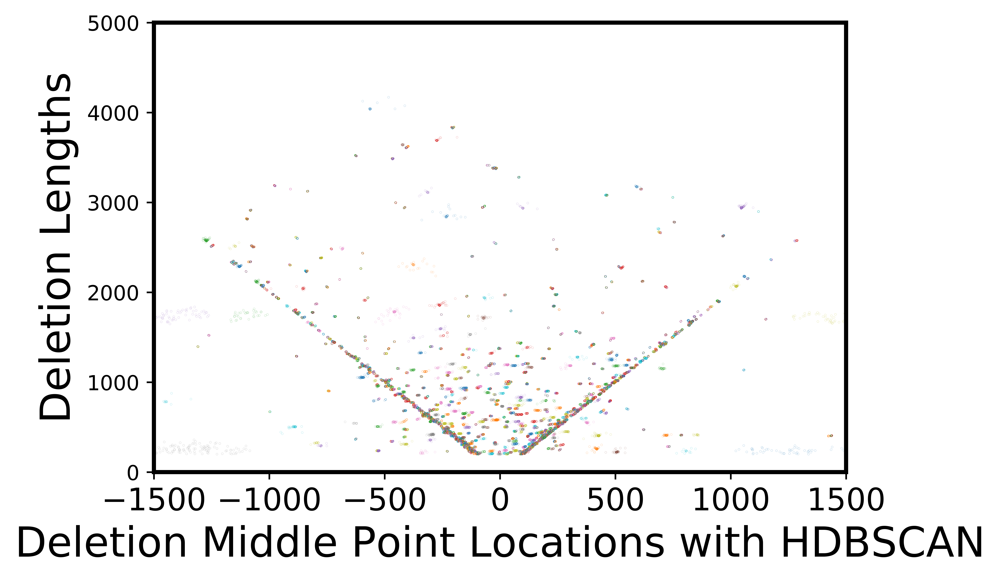

In [72]:
HDBClustersViz(15, DelsWhole)

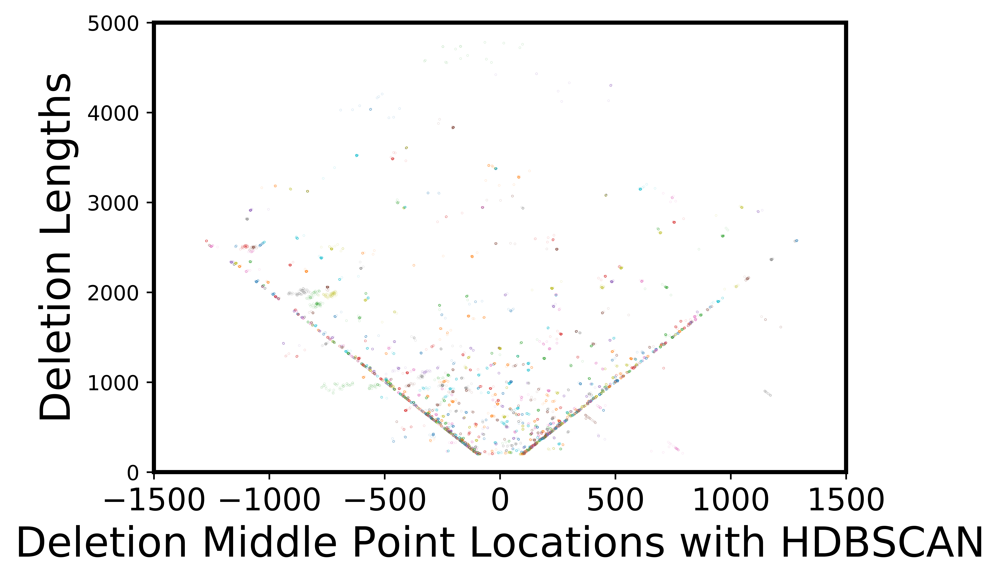

In [73]:
HDBClustersViz(15, all_dels_SR_nr)

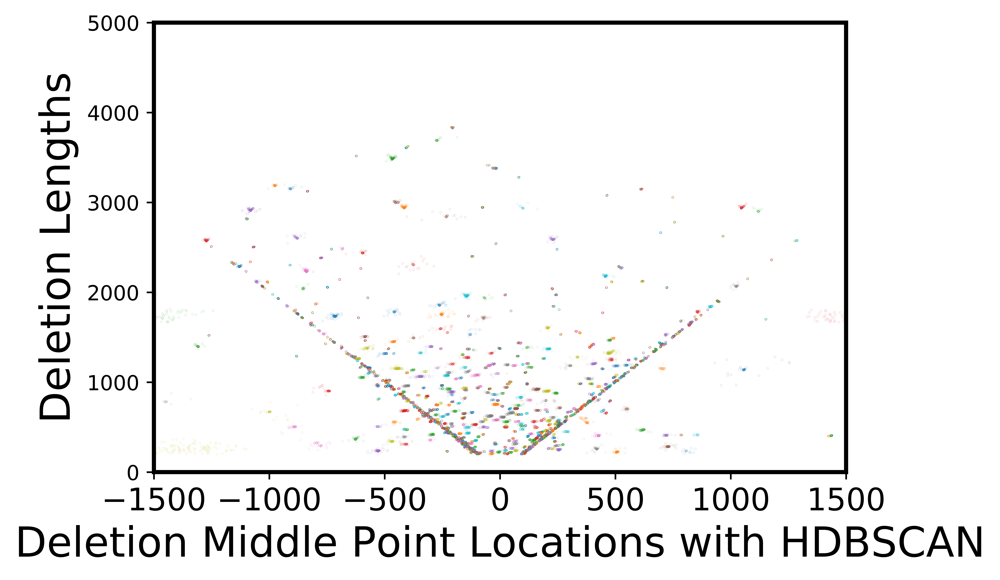

In [74]:
HDBClustersViz(30, DelsWhole)

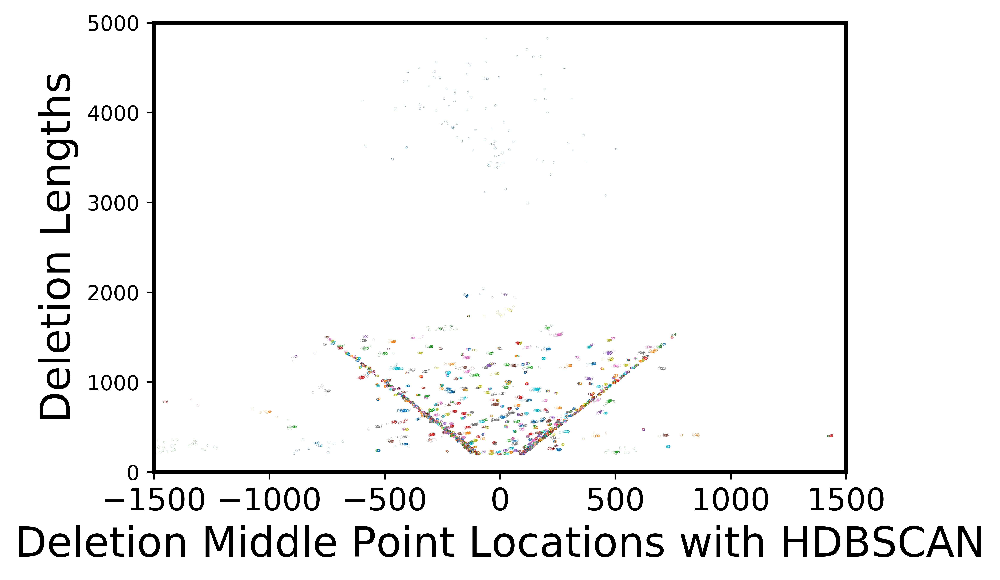

In [75]:
HDBClustersViz(25, DelswithBWA)

In [76]:
ClusterDelFreqViz(25, DelsWhole, 4, all_dels_SR_nr, 100, 1)


In [77]:
ClusterDelFreqViz(9, DelsWhole, 2, all_dels_SR_nr, 100, 1)

In [78]:
ClusterDelFreqViz(25, DelsWhole, 5, all_dels_SR_nr, 100000, 1)

In [79]:
ClusterDelFreqViz(25, DelsWhole, 5, all_dels_SR_nr, 10000, 1)

In [80]:
def RunHDBCluster_Multiple(circletimes, start, indel):
    clusternum_LR = []
    epslist_LR = []
    for k in tqdm(range(circletimes)):
        dd = HDBCluster(start, indel)
        for i in dd:
            temp_1 = []
            temp_2 = []
            for j in dd[i]:
                temp_1.append(j[0]+j[1]/2)
                temp_2.append(j[1])
        clusternum_LR.append(len(dd))
        epslist_LR.append(start)
        start += 1
    fig = go.Figure()
    fig.add_trace(go.Bar(x= epslist_LR, y=clusternum_LR,  name='cluster numbers change with max distance'))
    fig.show()
    return clusternum_LR

### OPTICS Cluster

In [81]:
def OPCluster(min_samples_size, indel):
    dbscan_clusters = OPTICS(min_samples = min_samples_size).fit(indel)
    labels = dbscan_clusters.labels_
#     n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    clstrdic = {}
    for j in range(len(indel)):
        if labels[j] != -1:
            if labels[j] not in clstrdic:
                clstrdic.update({labels[j] : [indel[j]]})
            else:
                clstrdic[labels[j]].append(indel[j])
    return clstrdic

def OPClustersViz(min_samples_size, indel):
    clstrdic = DBCluster(min_samples_size, indel)
    plt.figure()
    plt.axis([-1500,1500,0,5000])
    for i in clstrdic:
        temp_1 = []
        temp_2 = []
        for j in clstrdic[i]:
            temp_1.append(j[0]+j[1]/2)
            temp_2.append(j[1])
        plt.scatter(x=temp_1, y=temp_2, s=0.001)
    plt.xlabel("Deletion Middle Point Locations")
    plt.ylabel("Deletion Lengths")
    plt.show()

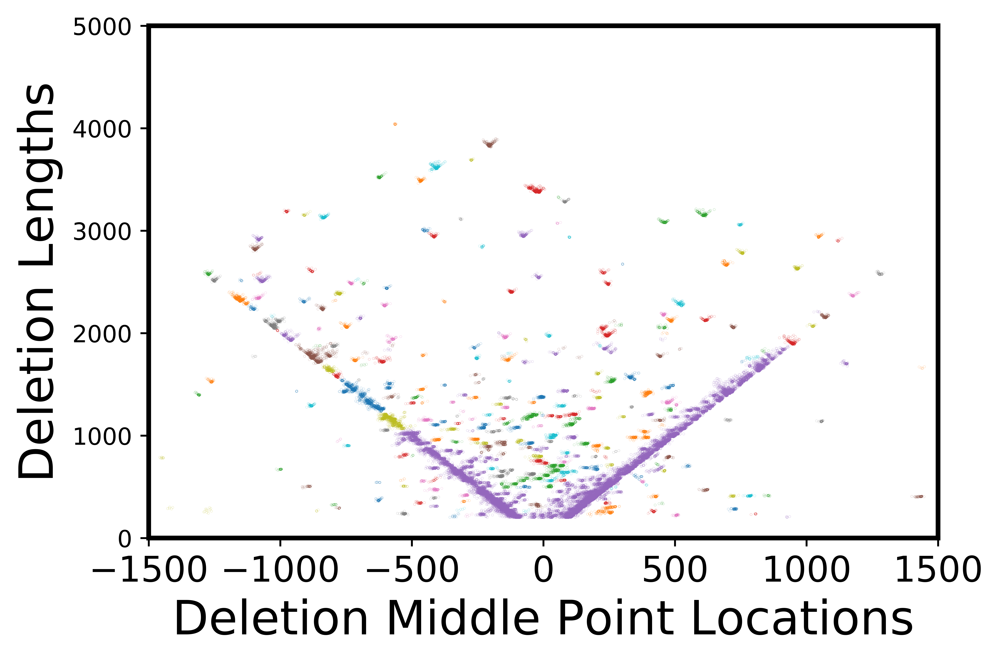

In [82]:
OPClustersViz(15, DelsWhole)

### T-SNE Visualization

In [83]:
DelsWhole_embedded = TSNE(n_components=3, n_jobs=50).fit_transform(DelsWhole)

In [84]:
DelsWhole_embedded

array([[  2.3041253,   4.72448  ,  -2.865537 ],
       [  0.8701192, -12.226857 ,  -1.4491321],
       [  2.0305524,  -5.8319135, -12.073797 ],
       ...,
       [ 18.031914 ,   1.5346055,   4.1699557],
       [ 18.033825 ,   1.5332664,   4.1711864],
       [ 18.032393 ,   1.534847 ,   4.170579 ]], dtype=float32)

In [85]:
temp_1 = []
temp_2 = []
temp_3 = []
for i in DelsWhole_embedded:
    temp_1.append(i[0])
    temp_2.append(i[1])
    temp_3.append(i[2])


In [86]:
# from matplotlib import pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D

# fig=plt.figure()
# ax2 = Axes3D(fig)

# ax2.scatter3D(temp_1,temp_2,temp_3,s=0.001)

In [87]:
# plt.scatter(x=DelsWhole_embedded, y=[0]*len(DelsWhole_embedded), s=0.001)

In [88]:
len(DelsWhole_embedded)

230514

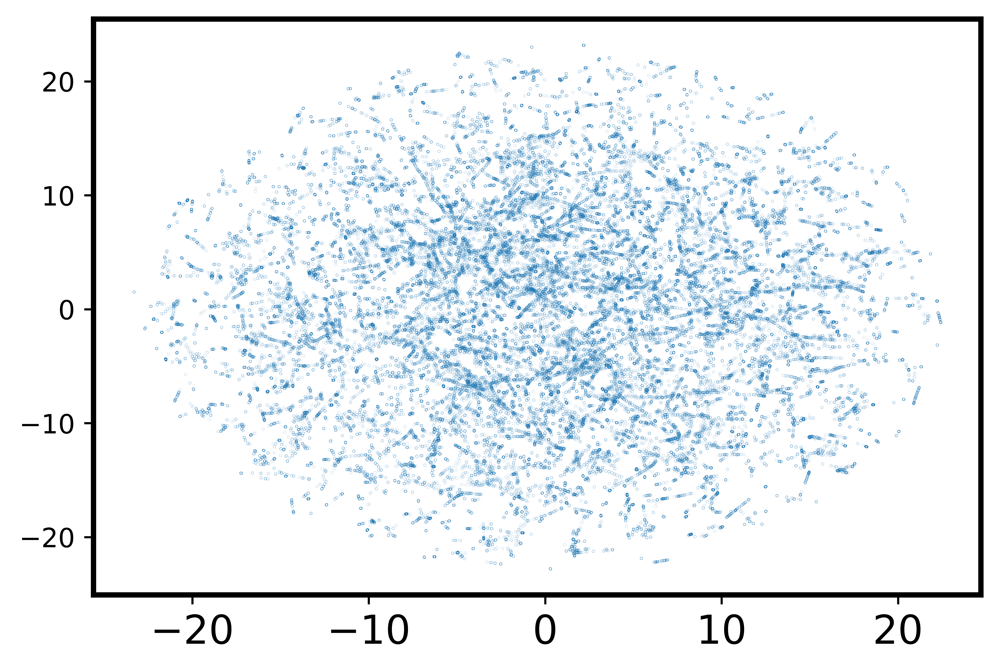

In [89]:
temp_1 = []
temp_2 = []
for i in DelsWhole_embedded:
    temp_1.append(i[0])
    temp_2.append(i[1])
plt.scatter(x=temp_1, y=temp_2, s=0.001)

In [90]:
plt.scatter(DelsWhole_embedded, s=0.001)

TypeError: scatter() missing 1 required positional argument: 'y'

### Trying Parallel

In [ ]:
cluster = ipyparallel.Client()
print('profile:', cluster.profile)
print("IDs:", cluster.ids) # Print process id numbers

In [ ]:
%px print("hosts:", socket.gethostname())

# calculate square numbers in parallel. Print result.
squares = cluster[:].map_sync(lambda x: x**2, range(32))
print("squares:", squares)

In [ ]:
hdb_cluster_num_lr = RunHDBCluster_Multiple(30, 2, DelsWhole)

In [ ]:
def get_hdb_clusters(filename):
    df = pd.read_csv(filename)
    SR_Dels = []
    for i in df.values:
        for j in range(i[2]):
            SR_Dels.append([i[0] - 5248230, i[1]])
    clusternum_SR = []
    start = 2
    epslist_SR = []
    for k in tqdm(range(30)):
        dbscan_clusters = list(hdbscan.HDBSCAN(min_cluster_size=start).fit_predict(SR_Dels))
        clstrdic = {}
        labels = dbscan_clusters
        for j in range(len(SR_Dels)):
            if labels[j] != -1:
                if labels[j] not in clstrdic:
                    clstrdic.update({labels[j] : [SR_Dels[j]]})
                else:
                    clstrdic[labels[j]].append(SR_Dels[j])

        clusternum_SR.append(len(clstrdic))
        epslist_SR.append(start)
        start += 1
    return clusternum_SR

In [ ]:
final_clusters = {}
for m in os.listdir("For_Clustering/"):
    final_clusters.update({m.split(".")[0]:get_hdb_clusters("For_Clustering/"+m)})
start = 1
epslist_SR = []
for k in range(35):
    epslist_SR.append(start)
    start += 1
fig = go.Figure()
fig.add_trace(go.Line(x= epslist_SR, 
                      y = hdb_cluster_num_lr, 
                      name='HiFi CRISPR Cas9 System R66SCD targeting to HBB Region, Nanopore High coverage'))
for i in final_clusters:
    fig.add_trace(go.Line(x= epslist_SR, y=final_clusters[i], name = i))
fig.update_layout(
    title={'text':"Cluster Number Changes with n_components in different Samples",
           'y':0.01,
          },
    xaxis_title="ε",
    yaxis_title="Cluster Numbers",
    legend=dict(x=0, y=1.8, font=dict(size=7)),
    )
fig.show()

### Bayesian Gaussian Mixture Model

In [ ]:
BGM_Clusterer = BayesianGaussianMixture(n_components=20)

In [ ]:
b = BGM_Clusterer.fit_predict(DelsWhole)

In [ ]:
list(b)

In [ ]:
def BGMCluster(indel):
    clusterer = BayesianGaussianMixture()
    dbscan_clusters_labels = list(clusterer.fit_predict(indel))
#     labels = dbscan_clusters
#     n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    clstrdic = {}
    for j in range(len(dbscan_clusters_labels)):
        if dbscan_clusters_labels[j] != 0:
            if dbscan_clusters_labels[j] not in clstrdic:
                clstrdic.update({dbscan_clusters_labels[j] : [indel[j]]})
            else:
                clstrdic[dbscan_clusters_labels[j]].append(indel[j])
    return clstrdic

def BGMClustersViz(indel):
    clstrdic = BGMCluster(indel)
    plt.figure()
    plt.axis([-1500,1500,0,5000])
    for i in clstrdic:
        temp_1 = []
        temp_2 = []
        for j in clstrdic[i]:
            temp_1.append(j[0]+j[1]/2)
            temp_2.append(j[1])
        plt.scatter(x=temp_1, y=temp_2, s=0.001)
    plt.xlabel("Deletion Middle Point Locations")
    plt.ylabel("Deletion Lengths")
    plt.show()

In [ ]:
BGMClustersViz(DelsWhole)

In [ ]:
VizFrequencyChange(DelsWhole, len(reads), 0)


In [ ]:
def getstats(indel, readnum):
    locdic = {}
    for i in indel:
        temploc = int(i[1]/100)*100
        if temploc not in locdic:
            locdic.update({temploc:0})
        else:
            locdic[temploc] += 1
    locdic1 = sorted(locdic.items())
    locdic2_1 = []
    locdic2_2 = []
    for i in locdic1:
        locdic2_1.append(i[0])
        locdic2_2.append( np.round(i[1]/(len(DelsWhole)), decimals=5))
    return locdic2_1, locdic2_2


In [ ]:
s = getstats(DelsWhole, len(reads))

In [ ]:
print(s)

In [ ]:
for i in range(len(s[0])):
    print(f"{s[1][i]},{s[0][i]}")

In [ ]:
def func(x, a, b):
    return b + a / x


In [ ]:
params = np.array([1,1])

res = curve_fit(func, s[0], s[1], params)


In [ ]:
res

In [ ]:
plt.scatter(s[0], s[1])
s_fit = []
for i in s[0]:
    s_fit.append(-8.51243308e-04+2.97666917e+01 / i)


plt.plot(s[0], s_fit)

In [ ]:
s_fit = []
for i in s[0]:
    s_fit.append(8.32 - 2.37529158e-04 / i)


In [ ]:
s_fit

In [ ]:
len(DelsWhole)

In [ ]:
len(reads)

In [ ]:
230514 / 826064

In [ ]:
clstrdic_illumina_dbscan1 = DBCluster(0.5, all_dels_SR_nr)

In [ ]:
profile = ClusterDistribution(0.5, all_dels_SR_nr)
print(profile)
df1 = np.array(profile, dtype=int)
df1[0] = df1[0] + 5248230
df = pd.DataFrame().append(df1)
df.to_csv(r'illumina_DBSCAN_epi1.csv')

In [ ]:
df_501 = pd.read_csv("./Illumina/R66SHIFI-2_501largedel_group.csv")
all_dels_SR501 = df_501.values
all_dels_SR501_nr = []
for i in all_dels_SR501:
    for j in range(i[2]):
        all_dels_SR501_nr.append([i[0]-5248230, i[1]])

